In [18]:
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
from scipy.stats import t
import math
import seaborn as sns
import numpy as np
from numpy.polynomial.polynomial import polyfit
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

Base paper: https://www.frontiersin.org/articles/10.3389/fmed.2020.607786/full


*   corona data: https://datahub.io/core/covid-19
*   temp anomaly data: https://data.giss.nasa.gov/gistemp/
*   climate data: https://www.kaggle.com/berkeleyearth/climate-change-earth-surface-temperature-data
*   población mundial: https://worldpopulationreview.com/









# Introducción

A principios del 2020, el sars-cov-2 nació y ha ido esparciéndose alrededor del mundo. Independientemente de la población, los gobiernos, técnicas médicas y condiciones medio ambientales ha logrado sobrevivir y evolucionar. Se han hecho múltiples estudios sobre la sobrevivencia del virus a pesar de las variables antes mencionadas. Sin embargo, a pesar de eso existen rumores populares (tales como en Venezuela) que afirman que el Sars-Cov-2 no es capaz de desenvolverse por completo a altas temperaturas. A raíz de esta afirmación popular y estudios tales como [Kifer et al](https://www.frontiersin.org/articles/10.3389/fmed.2020.607786/full) sobre la influencia de las condiciones medioambientales en la severidad y mortalidad del Sars-Cov-2, se ha planteado realizar un análisis acerca del efecto de la temperatura sobre el impacto de dicha enfermadad en quiénes se han contagiado, definiendo como severidad la duración de la recuperación de una persona de dicha enfermedad. Se pone énfasis en variables tales como: 


*   Mortalidad vs. Recuperaciones entre 2020 y 2021 en relación a las variaciones de la temperatura a nivel global producto del cambio climático. 
*   Porcentaje de personas en recuperación a lo largo del 2020 y 2021 en relación con sus temperaturas promedio. 







## Pregunta: 
  ¿La temperatura es un factor de importancia en la severidad de los casos de Sars-Cov-2?

Teniendo en mente esta interrogante, asumiremos como hipótesis a lo largo del análisis de los datos encontrados que la temperatura sí es un factor que influye en la severidad de los casos de Sars-Cov-2, disminuyendo el número de pacientes recuperados, alargando el tiempo de recuperación de los mismos mediante complicaciones de salud en sus casos. 



# Estudio 1: Severidad de los casos de Sars-Cov-2 en relación a la variación de la temperatura en el mundo 

Ya que se tiene a la mano una data las variaciones globales de temperatura, producto del cambio climático, y data sobre los casos de covid confirmados, pacientes recuperados y muertes por país entre el 2020 y 2021, es de nuestro interés estudiar si efectivamente el cambio de comportamiento de la temperatura global tiene algún efecto en los casos de sars-cov-2 a nivel global.   

Fuentes de datos: 

*   Estado del sars-cov-2 a nivel global: https://datahub.io/core/covid-19
*   Variaciones en la temperatura global: https://data.giss.nasa.gov/gistemp/



In [19]:
# Configuramos ciertas variables que nos ayudarán en el manejo de las columnas al analizar los dataframes y procesarlos para generar las gráficas.
MONTHS = [
    "January", 
    "February", 
    "March", 
    "April", 
    "May", 
    "June", 
    "July", 
    "August", 
    "September", 
    "October", 
    "November", 
    "December"
]
MONTHS_DICT = {element:element[:3] for element in MONTHS}
COLUMNS = ["Year"] + list(MONTHS_DICT.values())
YEARS = [2020, 2021]
VARIABLES = ['Recovered', 'Deaths']

Definimos las funciones a implementar para limpiar y procesar nuestros datos:

In [20]:
def replace_empty_variations(df):
  """
    Debido que hay meses sin data disponible, representando como *** dicha falta de información, estos se reemplazan por objetos del tipo NaN para mejor procesamiento. 
  """
  months_short = list(MONTHS_DICT.values())
  for month in months_short:
    df[month] = df[month].replace('***', np.NaN).astype(float)

In [21]:
def standard_months(element):
  """
    Convierte los nombres completos de los meses en sus respectivos seudónimos, tal que pasamos 'Septiembre' a 'Sep' por ejemplo.
  """
  return MONTHS_DICT[element['Month']]

In [22]:
def replace_nulls(info):
  """
  Reemplazamos los valores NaN por el promedio de los valores para una variable determinada, siendo las posibles variables: Temperature variation, Deaths o Recovered. 
  """
  info[np.isnan(info)] = np.nanmean(info)
  return info

In [23]:
def get_info_arrays(df_anomalies, df_corona):
  """
  Obtenemos un diccionario anidado, donde cada llave es un año y dentro de los mismos tenemos un vector numpy por cada variable a estudiar por año. 
  Args:
    - df_anomalies: <DataFrame> con las variaciones de temperatura por mes y año. 
    - df_corona: <DataFrame> con las variables a estudiar como columnas, siendo estas: Temperature variation, Deaths & Recovered por mes y año.
  Returns:
    - info_arrays: <dict> con la información de las variaciones de temperatura, recuperaciones y muertes tal que cada año tiene la siquiente estructura de acuerdo a las variables estudiadas:
        {2020: {
          'Deaths': <np.array>,
          'Recovered': <np.array>,
          'Temperature variation': <np.array>
  """
  info_arrays = {}
  short_months = list(MONTHS_DICT.values())
  for year in YEARS:
    info_arrays[year] = {}
    info_arrays[year]['Temperature variation'] = replace_nulls(np.array(df_anomalies.loc[df_anomalies['Year'] == year][short_months]).flatten().astype(np.float))
    for variable in VARIABLES:
      info_arrays[year][variable] = replace_nulls(np.array(df_corona.loc[df_corona['Year']== year][variable]).flatten().astype(np.float))
  return info_arrays

In [24]:
def draw_recoveries_and_deaths_per_year(info_arrays, total_per_ax):
  """
    Se dibujan las gráficas para las muertes y recuperaciones globales a causa del sars-cov-2 de acuerdo a los años señalados.
    Args: 
      - info_arrays : <dict> con la información de las variaciones de temperatura, recuperaciones y muertes. 
      - total_per_ax: <int>
  """
  fig, axs = plt.subplots(total_per_ax, total_per_ax)
  fig.suptitle("Deaths and Recoveries per year against temperature variations between 2020 and 2021")
  years = list(info_arrays.keys())
  variables = list(info_arrays[years[0]].keys())[1:]
  i = 0
  for element in axs:
      row, column = element
      row.set_title(f'Recovered in {years[i]}', pad=4)
      row.scatter(info_arrays[years[i]]['Temperature variation'], info_arrays[years[i]]['Recovered'], c='b')
      b, m = polyfit(info_arrays[years[i]]['Temperature variation'], info_arrays[years[i]]['Recovered'], 1)
      row.plot(info_arrays[years[i]]['Temperature variation'], b + m * info_arrays[years[i]]['Temperature variation'], '-')

      column.set_title(f'Deaths in {years[i]}', pad=4)
      column.scatter(info_arrays[years[i]]['Temperature variation'], info_arrays[years[i]]['Deaths'], c='r')
      b, m = polyfit(info_arrays[years[i]]['Temperature variation'], info_arrays[years[i]]['Deaths'], 1)
      column.plot(info_arrays[years[i]]['Temperature variation'], b + m * info_arrays[years[i]]['Temperature variation'], '-', c='r')
      i = i + 1
  fig.tight_layout()


In [25]:
df_anomalies = pd.read_csv("../data/GLB.Ts+dSST (1).csv", header=1, index_col=0, usecols=COLUMNS)
df_anomalies = df_anomalies.reset_index()
df_anomalies.info()
df_anomalies.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 142 entries, 0 to 141
Data columns (total 13 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Year    142 non-null    int64  
 1   Jan     142 non-null    float64
 2   Feb     142 non-null    float64
 3   Mar     142 non-null    float64
 4   Apr     142 non-null    float64
 5   May     142 non-null    float64
 6   Jun     142 non-null    float64
 7   Jul     142 non-null    float64
 8   Aug     142 non-null    float64
 9   Sep     142 non-null    float64
 10  Oct     142 non-null    object 
 11  Nov     142 non-null    object 
 12  Dec     142 non-null    object 
dtypes: float64(9), int64(1), object(3)
memory usage: 14.5+ KB


,Year,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
0,1880,-0.17,-0.23,-0.08,-0.15,-0.09,-0.20,-0.17,-0.09,-0.13,-.23,-.21,-.16
1,1881,-0.18,-0.13,0.04,0.06,0.07,-0.18,0.01,-0.02,-0.14,-.20,-.17,-.06
2,1882,0.17,0.15,0.05,-0.16,-0.13,-0.22,-0.15,-0.06,-0.14,-.23,-.16,-.36
3,1883,-0.28,-0.36,-0.12,-0.18,-0.17,-0.06,-0.06,-0.13,-0.21,-.11,-.23,-.10
4,1884,-0.12,-0.07,-0.36,-0.39,-0.33,-0.34,-0.32,-0.27,-0.26,-.24,-.32,-.30


In [26]:
replace_empty_variations(df_anomalies)
df_anomalies = df_anomalies[df_anomalies['Year'].isin(YEARS)]

In [27]:
df_anomalies

,Year,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
140,2020,1.16,1.25,1.17,1.13,1.02,0.92,0.91,0.88,0.99,0.89,1.11,0.82
141,2021,0.81,0.64,0.89,0.76,0.79,0.85,0.92,0.82,0.92,NaN,NaN,NaN


In [28]:
df_corona = pd.read_csv("../data/worldwide-aggregate_csv.csv")
df_corona.info()
df_corona.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 652 entries, 0 to 651
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           652 non-null    object 
 1   Confirmed      652 non-null    int64  
 2   Recovered      652 non-null    int64  
 3   Deaths         652 non-null    int64  
 4   Increase rate  651 non-null    float64
dtypes: float64(1), int64(3), object(1)
memory usage: 25.6+ KB


,Date,Confirmed,Recovered,Deaths,Increase rate
0,2020-01-22,557,30,17,NaN
1,2020-01-23,655,32,18,17.594255
2,2020-01-24,941,39,26,43.664122
3,2020-01-25,1434,42,42,52.391073
4,2020-01-26,2118,56,56,47.698745


In [29]:
df_corona['Date'] = pd.to_datetime(df_corona['Date'])
df_corona['Month'] = pd.DatetimeIndex(df_corona['Date']).month_name()
df_corona['Year'] = pd.DatetimeIndex(df_corona['Date']).year
df_corona.head()

,Date,Confirmed,Recovered,Deaths,Increase rate,Month,Year
0,2020-01-22,557,30,17,NaN,January,2020
1,2020-01-23,655,32,18,17.594255,January,2020
2,2020-01-24,941,39,26,43.664122,January,2020
3,2020-01-25,1434,42,42,52.391073,January,2020
4,2020-01-26,2118,56,56,47.698745,January,2020


In [30]:
df_corona['Month'] = df_corona.apply(lambda x: standard_months(x), axis=1)
df_corona['Month'] = pd.Categorical(df_corona['Month'], categories=list(MONTHS_DICT.values()), ordered=True)
df_corona = df_corona.groupby(['Year', 'Month'],as_index=False).sum()

In [31]:
info_arrays = get_info_arrays(df_anomalies, df_corona)

In [32]:
total_per_ax = int(sum(len(v) - 1  for v in info_arrays.values())/len(info_arrays))

Agregar una gráfica comparativa directamente donde se vea una gráfica de barras (recuperaciones, muerte) vs. variaciones de temperatura.

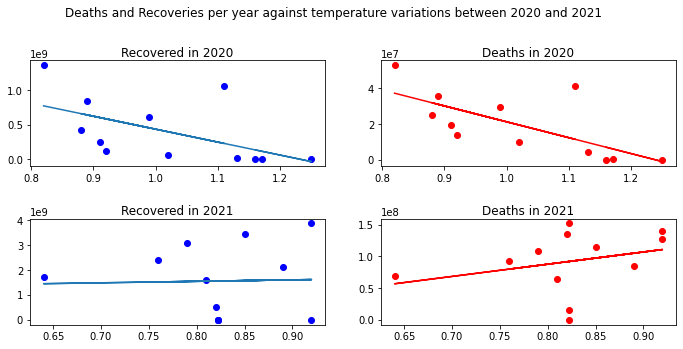

In [33]:
draw_recoveries_and_deaths_per_year(info_arrays, total_per_ax)
plt.gcf().set_size_inches(10, 5)
plt.show()

Analicemos el comportamiento de cada gráfica por año:

*   **Recuperaciones**: Los datos comparten una tendencia negativa, lo que describre que a medida que la variación de temperatura sea mayor las recuperaciones disminuyen, lo cual nos indica que la severidad del covid en el 2020 fue considerable y existió una relación con las variaciones de temperatura. Sin embargo en el 2021 la línea de tendencia no nos presenta una relación entre los datos. 
*   **Muertes**: En el 2020 las variaciones de temperatura y las muertes producto del sars-cov-2 tienen una tendencia negativa, tal como las recuperaciones. En otras palabras, las muertes disminuyeron a medida que las variaciones de temperatura eran mayores. En el 2021, a diferencia de las recuperaciones antes expuestas en el mismo año, tienen una tendencia positiva o sea hubo mayor cantidad de muertes a medida que hay mayor aumento de las variaciones de temperatura. 

Esto nos indica lo siguiente, en el 2020 al tener tanto las recuperaciones como las muertes, producto del Sars-Cov-2, tendencias negativas en relación con las variaciones de temperatura se puede decir disminuían las recuperaciones y las muertes por Sars-Cov-2 a medida que aumentaba la variación de temperatura, por lo cual se puede decir que o la población se enfermaba menos de Sars-Cov-2 o tomaban mayor tiempo de recuperación de la enfermedad. En el 2021, si bien las recuperaciones de los pacientes de Sars-Cov-2 no se vieron influenciadas por las variaciones de temperatura (puede deberse a factores como el refuerzo inmunológico de la población gracias a las jornadas de recuperación mundiales), si existe una relación directa entre las variaciones de temperatura y las muertes por Sars-Cov-2. Sin embargo, nos interesa profundizar esto con un análisis más detallado que explore la relación estudiada por país.


# Parte 2: Severidad de los casos por Sars-Cov-2 por país en relación a sus temperaturas

In [35]:
def get_population_value(element):
  population_columns = {
      '2021': 'pop2021',
      '2020': 'pop2020'
  }
  return element[population_columns[element['Date'][-4:]]]*1000

In [34]:
# Lectura de poblaciones mundiales entre 2020 y 2021
df_population = pd.read_csv('../data/population.csv', usecols=['name', 'pop2021', 'pop2020'])
df_population = df_population.rename(columns={"name":"Country"})
df_population.info()
df_population.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232 entries, 0 to 231
Data columns (total 3 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Country  232 non-null    object 
 1   pop2021  232 non-null    float64
 2   pop2020  232 non-null    float64
dtypes: float64(2), object(1)
memory usage: 5.6+ KB


,Country,pop2021,pop2020
0,China,1444216.107,1439323.776
1,India,1393409.038,1380004.385
2,United States,332915.073,331002.651
3,Indonesia,276361.783,273523.615
4,Pakistan,225199.937,220892.340


In [36]:
# Lectura de las temperaturas por país
df_temperature = pd.read_csv('../data/GlobalLandTemperaturesByCountry.csv').reset_index()
df_temperature.info()
df_temperature.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 5 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   index                          577462 non-null  int64  
 1   dt                             577462 non-null  object 
 2   AverageTemperature             544811 non-null  float64
 3   AverageTemperatureUncertainty  545550 non-null  float64
 4   Country                        577462 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 22.0+ MB


,index,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,0,1743-11-01,4.384,2.294,Åland
1,1,1743-12-01,NaN,NaN,Åland
2,2,1744-01-01,NaN,NaN,Åland
3,3,1744-02-01,NaN,NaN,Åland
4,4,1744-03-01,NaN,NaN,Åland


In [37]:
# Lectura del status de Covid por país
df_corona_by_country = pd.read_csv('../data/countries-aggregated_csv.csv')
df_corona_by_country.info()
df_corona_by_country.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 127792 entries, 0 to 127791
Data columns (total 5 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   Date       127792 non-null  object
 1   Country    127792 non-null  object
 2   Confirmed  127792 non-null  int64 
 3   Recovered  127792 non-null  int64 
 4   Deaths     127792 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 4.9+ MB


,Date,Country,Confirmed,Recovered,Deaths
0,2020-01-22,Afghanistan,0,0,0
1,2020-01-23,Afghanistan,0,0,0
2,2020-01-24,Afghanistan,0,0,0
3,2020-01-25,Afghanistan,0,0,0
4,2020-01-26,Afghanistan,0,0,0


In [38]:
# Estandarización de los nombres de los países donde se considere necesario, ya que las agrupaciones entre los dataframes
# se harán en base a los países.
countries_dict = {
    'Congo (Brazzaville)': 'Congo',
    'Congo (Kinshasa)' : 'Congo',
    'Korea, South': 'South Korea',
    'Taiwan*': 'Taiwan',
    'US': 'United States'
}
formated_df_corona_by_country = df_corona_by_country.replace(countries_dict)

formated_df_temperature = df_temperature.replace(['Denmark (Europe)', 'France (Europe)', 'Netherlands (Europe)', 'United Kingdom (Europe)'], ['Denmark', 'France', 'Netherlands', 'United Kingdom'])

In [39]:
# Obtenemos la totalidad de los pacientes en recuperación, tomando los casos confirmados como la totalidad de los casos de Sars-Cov-2 confirmados por mes.
formated_df_corona_by_country['In recovery'] = formated_df_corona_by_country['Confirmed'] - formated_df_corona_by_country['Deaths'] - formated_df_corona_by_country['Recovered']

In [40]:
# Procesamiento de la data tal que obtengamos los casos en recuperación por fecha y país. 
formated_df_corona_by_country = formated_df_corona_by_country.groupby(['Date', 'Country'], as_index=False).max().reset_index()
formated_df_corona_by_country['Date'] = pd.to_datetime(formated_df_corona_by_country['Date'])
formated_df_corona_by_country['Date'] = formated_df_corona_by_country['Date'].dt.strftime('%d/%m/%Y')
formated_df_corona_by_country['In recovery'] = formated_df_corona_by_country['In recovery'].clip(lower=0)

In [41]:
# Unión de dataframes de temperaturas por país y casos de sars-cov-2 tal que tengamos la totalida de la data en 
# un mismo dataframe.
formated_df_temperature = formated_df_temperature.groupby('Country', as_index=False).mean()
complete_df = formated_df_corona_by_country.merge(formated_df_temperature, on='Country')

In [42]:
# Unimos la totalidad de la población a nuestro dataframe, tal que en adición a las temperaturas y los casos de 
# Sars-Cov-2 se tengan los registros de la cantida de población por país.
complete_df = df_population.merge(complete_df, on='Country')
complete_df['Total population'] = complete_df.apply(lambda x: get_population_value(x), axis=1)
complete_df = complete_df.drop(['pop2021', 'pop2020', 'AverageTemperatureUncertainty'], axis=1)

In [43]:
# Ya que cada país tiene mayor o menor cantidad de personas en recuperación, producto de su densidad poblacional y demás factores,
# se obtiene una medida del porcentaje de la población que se encuentra en recuperación por país y fecha. 
complete_df['In recovery percentage'] = (complete_df['In recovery'] / complete_df['Total population'])*100
complete_df.head()

,Country,index_x,Date,Confirmed,Recovered,Deaths,In recovery,index_y,AverageTemperature,Total population,In recovery percentage
0,China,36,22/01/2020,548,28,17,503,111307.5,6.612731,1.439324e+09,0.000035
1,China,231,23/01/2020,643,30,18,595,111307.5,6.612731,1.439324e+09,0.000041
2,China,426,24/01/2020,920,36,26,858,111307.5,6.612731,1.439324e+09,0.000060
3,China,621,25/01/2020,1406,39,42,1325,111307.5,6.612731,1.439324e+09,0.000092
4,China,816,26/01/2020,2075,49,56,1970,111307.5,6.612731,1.439324e+09,0.000137


In [44]:
# Preparamos la data, ordenándola y haciendo parse de los datos para la graficación de los mismos. 
complete_df_size = complete_df.groupby(['Date', 'Country'], as_index=False).mean()
complete_df_size['Date'] = pd.to_datetime(complete_df_size['Date'])
complete_df_size.sort_values(by='Date', inplace=True, ascending=True)
complete_df_size['Date'] = complete_df_size['Date'].dt.strftime('%d/%m/%Y')

In [46]:
import plotly.express as px
import plotly.offline as py
import plotly.graph_objects as go

# Obtenemos el tamaño de las marcas en la gráfica a continuación.
complete_df_size = complete_df
complete_df_size['size'] = complete_df['In recovery percentage'].pow(0.7)

# Se construye una disporsión sobre el mapa global para ver la magnitud de la severidad de los casos de Sars-Cov-2.
fig = go.Figure(px.scatter_geo(complete_df_size, locations="Country", locationmode='country names', 
                     color="In recovery percentage", size="size", hover_name="Country", 
                     range_color= [0, max(complete_df_size["In recovery percentage"])], 
                     projection="natural earth", animation_frame="Date", template='ggplot2', 
                     title='In recovery population by country over time'))

# Se indican en el mapa geográfico la magnitud de las temperaturas en los países. 
fig.add_trace(
      go.Choropleth(
        locations = complete_df_size['Country'],
        z = complete_df_size['AverageTemperature'].astype(float),
        text = complete_df_size['Country'],
        locationmode = 'country names',
        colorscale= 'Blues',
        autocolorscale=False,
        reversescale=True,
        marker_line_color='white',
        marker_line_width=0.5,
        colorbar_title="Average temperatures"
    )
)
fig.update(layout_coloraxis_showscale=False)
fig.show()

Exponiendo lo anterior, se puede observar que a medida que pasa el tiempo aumentan en mayor o menor medida el porcentaje de la población que se encuentra en recuperación (sea en alguna institución médica o en sus hogares) gracias al Sars-Cov-2. Sin embargo, se puede hacer mención que en la parte norte del globo hay una mayor magnitud de la severidad de los casos por Sars-Cov-2 que en la parte sur. 

Además de esto, donde hay una mayor presencia de estas magnitudes son en países donde la temperatura ronda en los 10 grados Celsius. 

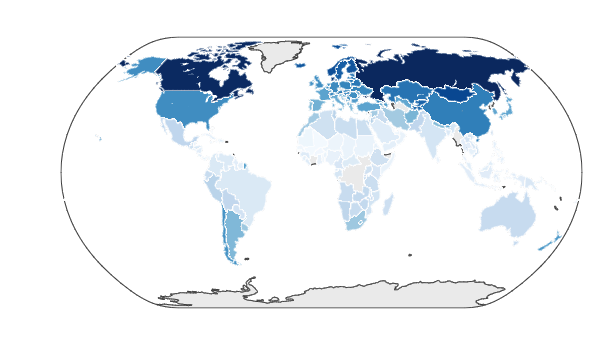

A continuación, se expone cómo ha sido el crecimiento del porcentaje de la población en recuperación gracias al Sars-Cov-2 en el mismo mes.


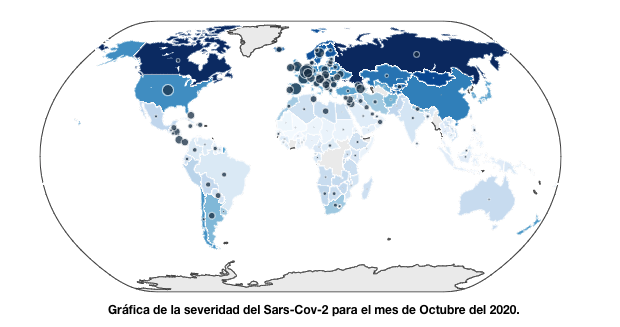

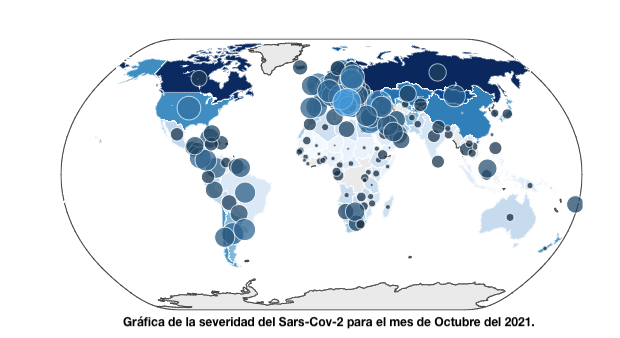

Según lo expuesto anteriormente, la relación entre la temperatura y la severidad del Sars-Cov-2 no está directamente relacionada con la magnitud de las temperaturas del país donde se encuentre. No se puede indicar que a mayor temperatura aumenta la severidad de un caso de Sars-Cov-2 y viceversa, pero se puede establecer que existe un rango de temperaturas que dan lugar a un aumento de la probabilidad de que en un país específico el Sars-Cov-2 sea más severo con su población.

# Parte 3: Estudio de las temperaturas donde el Sars-Cov-2 presenta una mayor severidad.

In [47]:
# Categorizamos la data de nuestro dataframe "comple_df" que contiene la data de la población completa, en recuperación y temperaturas.
complete_df_temperature = complete_df.round({'AverageTemperature': 1, 'In recovery percentage': 2})
complete_df_temperature = complete_df_temperature.groupby('AverageTemperature', as_index=False).sum()
complete_df_temperature.head()

,AverageTemperature,index_x,Confirmed,Recovered,Deaths,In recovery,index_y,Total population,In recovery percentage,size
0,-5.5,41476654,1962056598,1128064202,45321116,788671280,281328220.0,9.514238e+10,540.37,431.782292
1,-5.2,41404934,433225816,264248368,9968145,159009303,64368700.0,2.470789e+10,417.81,332.150960
2,-3.0,41414062,95123204,57832579,924300,36366325,92595410.0,3.782992e+09,625.73,439.216166
3,-0.8,41460354,34767802,8101267,154989,26515252,227039114.0,2.153102e+09,796.12,470.475397
4,0.1,41468178,42173181,6420117,298706,35454358,254664680.0,3.548277e+09,648.92,543.548572


In [48]:
# Volvemos a calcular el porcentaje de personas en recuperación del Sars-Cov-2, sabiendo que que ahora el porcentaje no es por país sino por temperaturas. 
complete_df_temperature['In recovery percentage'] = complete_df_temperature['In recovery'] / complete_df_temperature['Total population']
complete_df_temperature = complete_df_temperature.sort_values(by='In recovery percentage', ascending=False)
complete_df_temperature

,AverageTemperature,index_x,Confirmed,Recovered,Deaths,In recovery,index_y,Total population,In recovery percentage,size
23,8.6,124397362,14007041822,552054017,277041266,13177946539,741166216.0,2.626946e+11,0.050165,3947.605487
7,2.4,41493606,319001562,0,5662055,313339507,330573780.0,6.603418e+09,0.047451,1693.680869
28,9.3,41464266,537037659,5133479,7059580,524844600,239488402.0,1.118367e+10,0.046930,1670.163456
30,9.5,41394502,364040584,3797810,10302904,349939870,38845508.0,7.569544e+09,0.046230,1677.958222
44,13.6,41490346,1358747941,71183831,32247261,1255316849,320835508.0,3.048118e+10,0.041183,1539.145193
...,...,...,...,...,...,...,...,...,...,...
108,27.1,82897888,15254085,8066985,1005831,6181270,394172468.0,3.977499e+10,0.000155,46.495990
34,10.4,41464918,1405336,964499,14008,426829,243448324.0,3.155888e+09,0.000135,21.665031
114,28.1,41401022,4441196,2924007,64207,1452982,55938340.0,1.381124e+10,0.000105,18.430472
110,27.5,82891368,4526023,2694204,154980,1676839,373574484.0,1.766370e+10,0.000095,76.866103


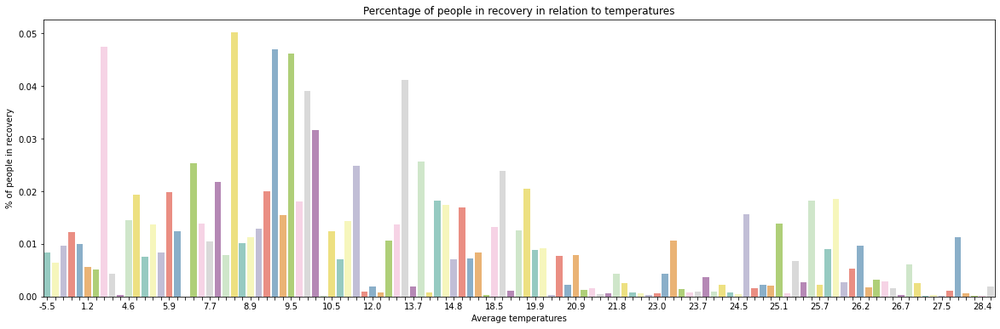

In [49]:
# Graficamos por categorías, obteniendo una visualización de la magnitud de las personas en recuperación por las temperaturas promedio calculadas anteriormente.
fig, ax = plt.subplots(figsize=(20,6), sharex=True)
barplot = sns.barplot(x="AverageTemperature", y="In recovery percentage", data=complete_df_temperature, palette="Set3")
ax.set_xlabel('Average temperatures')
ax.set_ylabel('% of people in recovery')
ax.set_title("Percentage of people in recovery in relation to temperatures")
for index, label in enumerate(barplot.get_xticklabels()):
   if index % 5 == 0:
      label.set_visible(True)
   else:
      label.set_visible(False)

plt.show()

Como se puede ver en esta gráfica, efectivamente comprobamos que la severidad del covid se concentra en las temperaturas alrededor de los 10 grados específicamente entre los 7 y 10 grados, considerando un pico de alrededor de los 2 grados y los 13 grados. 

# Conclusión y discusiones

A lo largo de este estudio, se ha podido determinar que la severidad de los casos de Sars-Cov-2, teniendo en cuenta que a mayor severidad de un caso de Sars-Cov-2 es mayor el tiempo de duración de la recuperación del individuo afectado, sí es afectado por la temperatura. Dentro de rangos de temperaturas determinadas el virus puede tener un mayor impacto en la recuperación del individuo, siendo el rango de mayor importancia entre los 7 y 10 grados, contrario a lo que se decía popularmente que a mayor temperatura del ambiente menor era el impacto del Sars-Cov-2. 

Por ende, a partir de este estudio también se obtiene como conclusión que aquellos países con temperaturas promedios en el rango señalado son quienes ven un mayor porcentaje de la población en recuperación por el virus en un plazo de tiempo. Esto puede influir en muchas políticas laborales debido a los reposos por enfermedad o, consecuentemente, en las economías de los países. Sin embargo, otros factores pueden dar lugar a este comportamiento tales como el impacto de los tipos de clima que suelen tener dichas temperaturas en las enfermedades populares o los factores de riesgos presentes en las poblaciones que se desenvuelven a diario en dichas temperaturas.

Como comentarios finales, se sugieren distintas oportunidades de mejora para este estudio:

*   Analizar la relación entre el Sars-Cov-2 y la temperatura de forma más exhaustiva teniendo a la mano un dataset de los casos de Sars-Cov-2 diarios por cada país así como las temperaturas diarias (en promedio) de cada país. 
*   Contrastar la temperatura con otros factores ambientales, tales como la humedad, la calidad del aire y demás en relación a la severidad del Sars-Cov-2. 

